In [133]:
!git clone https://github.com/idealo/image-super-resolution
!cd image-super-resolution


Cloning into 'face-recognition'...
remote: Enumerating objects: 15, done.
remote: Counting objects: 100% (15/15), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 170 (delta 7), reused 2 (delta 0), pack-reused 155
Receiving objects: 100% (170/170), 16.84 MiB | 854.00 KiB/s, done.
Resolving deltas: 100% (25/25), done.


In [58]:
import numpy as np
from PIL import Image
import os
from ISR.models import RDN, RRDN
import matplotlib.pyplot as plt

In [20]:
os.chdir(r'image-super-resolution')

In [26]:
os.getcwd()

'/Users/nathanredin/Documents/Machine Learning/projets/mbappe/image-super-resolution/image-super-resolution'

In [21]:
!python setup.py install

running install
running bdist_egg
running egg_info
creating ISR.egg-info
writing ISR.egg-info/PKG-INFO
writing dependency_links to ISR.egg-info/dependency_links.txt
writing requirements to ISR.egg-info/requires.txt
writing top-level names to ISR.egg-info/top_level.txt
writing manifest file 'ISR.egg-info/SOURCES.txt'
reading manifest file 'ISR.egg-info/SOURCES.txt'
writing manifest file 'ISR.egg-info/SOURCES.txt'
installing library code to build/bdist.macosx-10.9-x86_64/egg
running install_lib
running build_py
creating build
creating build/lib
creating build/lib/ISR
copying ISR/__init__.py -> build/lib/ISR
copying ISR/assistant.py -> build/lib/ISR
creating build/lib/ISR/models
copying ISR/models/__init__.py -> build/lib/ISR/models
copying ISR/models/cut_vgg19.py -> build/lib/ISR/models
copying ISR/models/discriminator.py -> build/lib/ISR/models
copying ISR/models/imagemodel.py -> build/lib/ISR/models
copying ISR/models/rdn.py -> build/lib/ISR/models
copying ISR/models/rrdn.py -> build/l

Searching for tensorflow-estimator<2.1.0,>=2.0.0
Reading https://pypi.org/simple/tensorflow-estimator/
Best match: tensorflow-estimator 2.0.1
Processing tensorflow_estimator-2.0.1-py2.py3-none-any.whl
Installing tensorflow_estimator-2.0.1-py2.py3-none-any.whl to /Users/nathanredin/anaconda3/lib/python3.7/site-packages
Adding tensorflow-estimator 2.0.1 to easy-install.pth file

Installed /Users/nathanredin/anaconda3/lib/python3.7/site-packages/tensorflow_estimator-2.0.1-py3.7.egg
Searching for tensorboard<2.1.0,>=2.0.0
Reading https://pypi.org/simple/tensorboard/
Best match: tensorboard 2.0.2
Processing tensorboard-2.0.2-py3-none-any.whl
Installing tensorboard-2.0.2-py3-none-any.whl to /Users/nathanredin/anaconda3/lib/python3.7/site-packages
writing requirements to /Users/nathanredin/anaconda3/lib/python3.7/site-packages/tensorboard-2.0.2-py3.7.egg/EGG-INFO/requires.txt
Adding tensorboard 2.0.2 to easy-install.pth file
Installing tensorboard script to /Users/nathanredin/anaconda3/bin

I

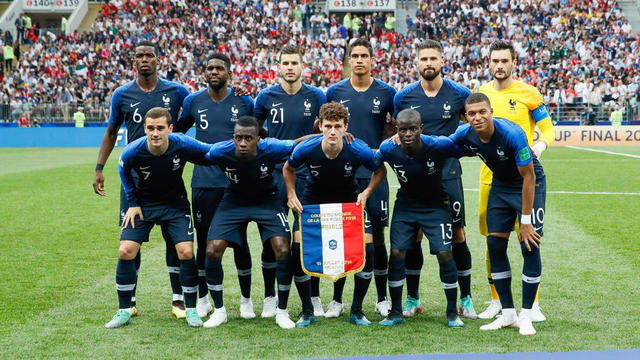

In [29]:
img = Image.open(r'/Users/nathanredin/Downloads/football_equipe_de_france_calendrier_2019_0.jpg')
lr_img = np.array(img)
img

In [111]:
img.size

(640, 360)

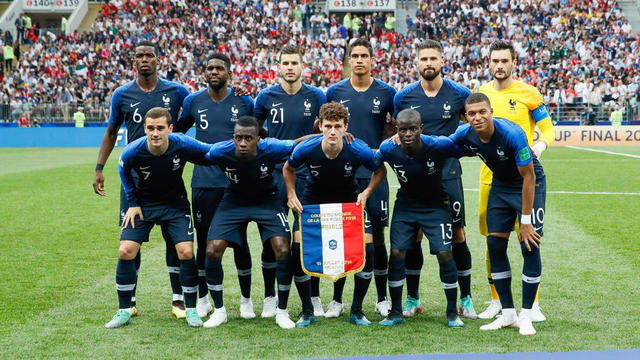

In [34]:
img.resize(size=(img.size[0]*4, img.size[1]*4), resample=Image.BICUBIC)


## RRDN noise-cancel

In [112]:
model = RDN(weights='noise-cancel')

66076672/66071288 [==============================] - 68s 1us/step


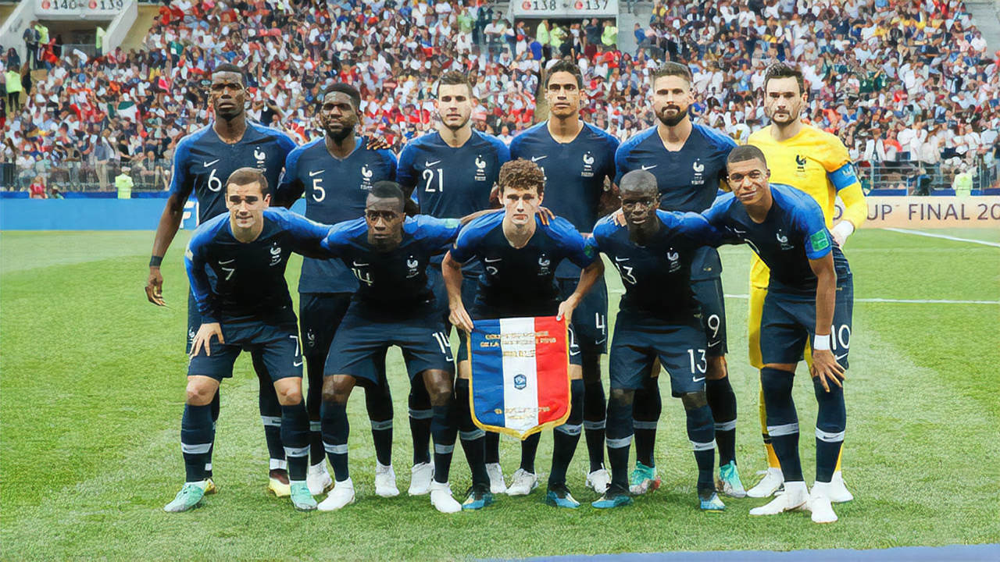

In [113]:
sr_img = model.predict(np.array(img))
Image.fromarray(sr_img)

In [114]:
bm = Image.fromarray(np.array(img)[0:100,450:550,:])
bm1 = bm.resize(size=(bm.size[0]*4, bm.size[1]*4), resample=Image.BICUBIC)
pred = Image.fromarray(sr_img[0:200,900:1100,:])
pred = pred.resize(size=(pred.size[0]*2, pred.size[1]*2), resample=Image.BICUBIC)

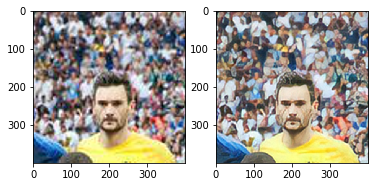

In [115]:
f = plt.figure()
f.add_subplot(1,2, 1)
plt.imshow(bm1)
f.add_subplot(1,2, 2)
plt.imshow(pred)
plt.show()

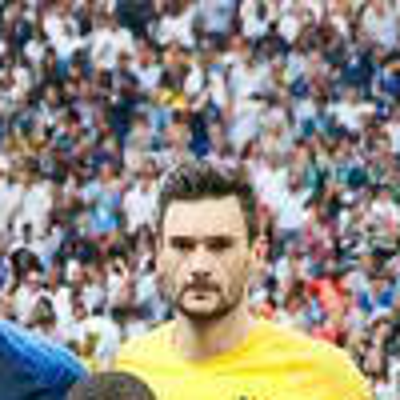

In [116]:
bm1

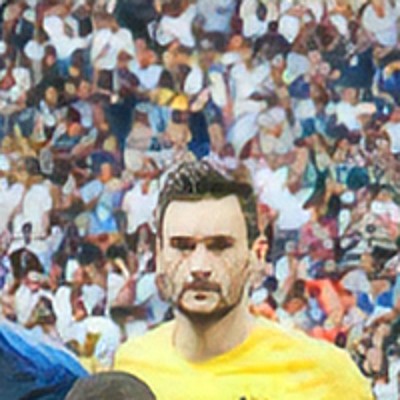

In [117]:
pred

## RRDN gans

In [118]:
model = RRDN(weights='gans')

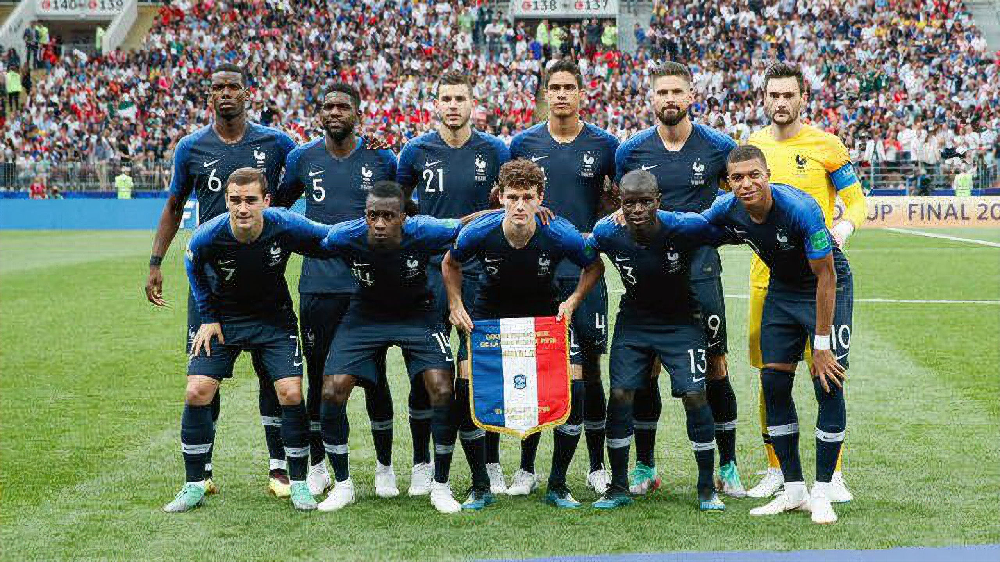

In [119]:
sr_img = model.predict(np.array(img))
Image.fromarray(sr_img)

In [129]:
bm = Image.fromarray(np.array(img)[0:100,450:550,:])
bm1 = bm.resize(size=(bm.size[0]*4, bm.size[1]*4), resample=Image.BICUBIC)
pred = Image.fromarray(sr_img[0:400,1800:2200,:])
pred = pred.resize(size=(pred.size[0], pred.size[1]), resample=Image.BICUBIC)

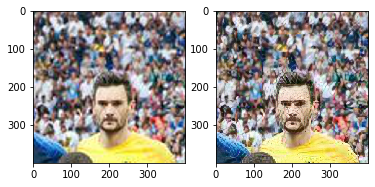

In [130]:
f = plt.figure()
f.add_subplot(1,2, 1)
plt.imshow(bm1)
f.add_subplot(1,2, 2)
plt.imshow(pred)
plt.show()

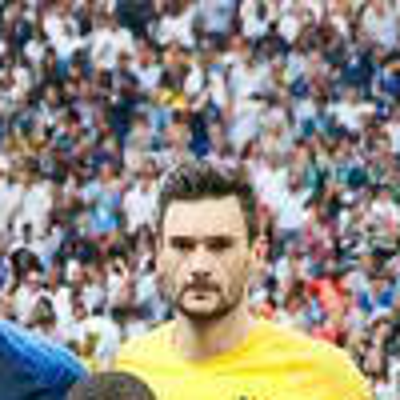

In [131]:
bm1

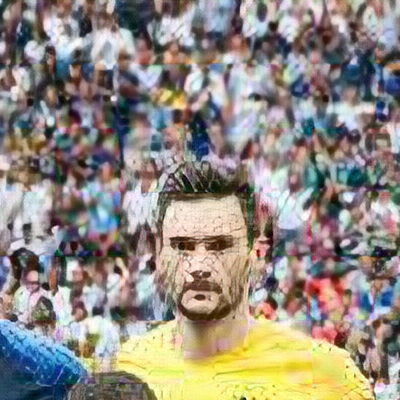

In [132]:
pred

## RDN psnr-small

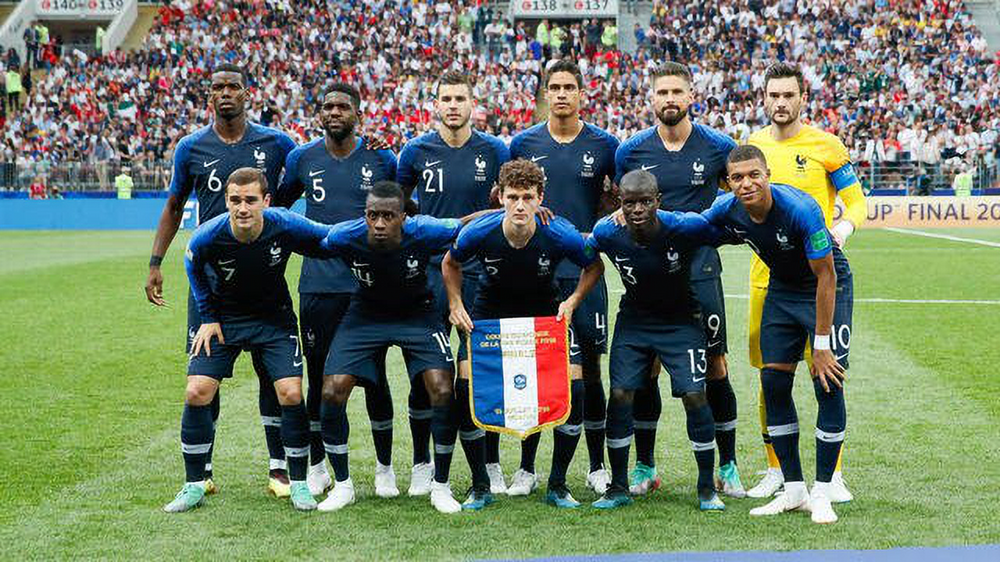

In [99]:
model = RDN(weights='psnr-small')
sr_img = model.predict(np.array(img))
Image.fromarray(sr_img)

In [100]:
bm = Image.fromarray(np.array(img)[0:100,450:550,:])
bm1 = bm.resize(size=(bm.size[0]*4, bm.size[1]*4), resample=Image.BICUBIC)
pred = Image.fromarray(sr_img[0:200,900:1100,:])
pred = pred.resize(size=(pred.size[0]*2, pred.size[1]*2), resample=Image.BICUBIC)

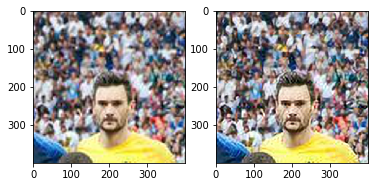

In [101]:
f = plt.figure()
f.add_subplot(1,2, 1)
plt.imshow(bm1)
f.add_subplot(1,2, 2)
plt.imshow(pred)
plt.show()

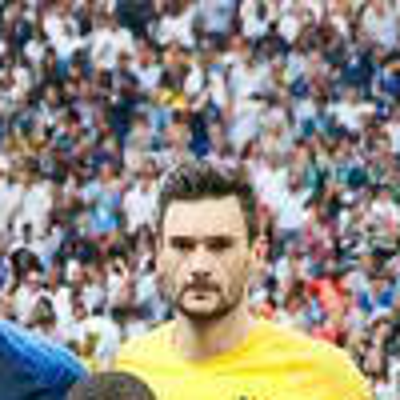

In [102]:
bm1

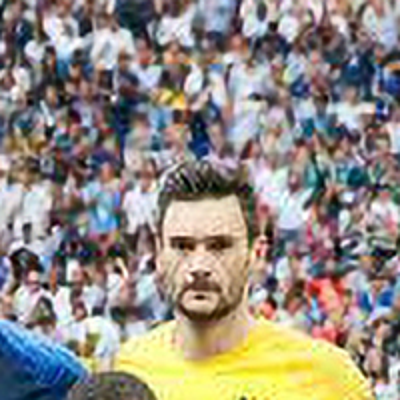

In [103]:
pred

## RDN psnr-large

66076672/66071288 [==============================] - 64s 1us/step


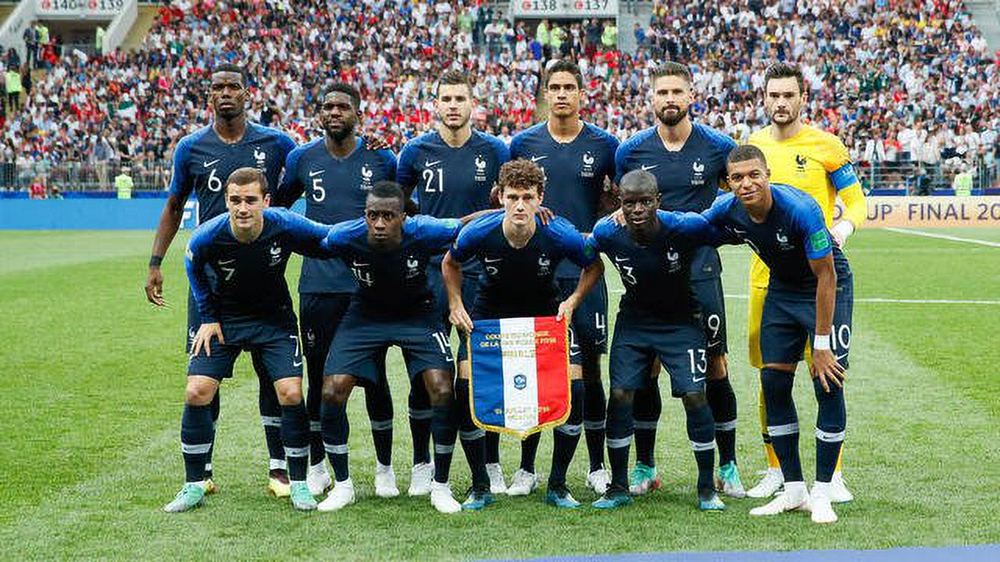

In [37]:
model = RDN(weights='psnr-large')
sr_img = model.predict(np.array(img))
Image.fromarray(sr_img)

In [95]:
bm = Image.fromarray(np.array(img)[0:100,450:550,:])
bm1 = bm.resize(size=(bm.size[0]*4, bm.size[1]*4), resample=Image.BICUBIC)
pred = Image.fromarray(sr_img[0:200,900:1100,:])
pred = pred.resize(size=(pred.size[0]*2, pred.size[1]*2), resample=Image.BICUBIC)

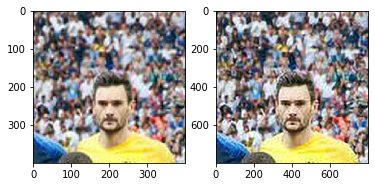

In [91]:
f = plt.figure()
f.add_subplot(1,2, 1)
plt.imshow(bm1)
f.add_subplot(1,2, 2)
plt.imshow(pred)
plt.show()

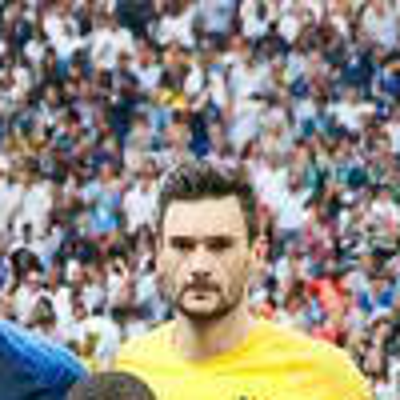

In [96]:
bm1

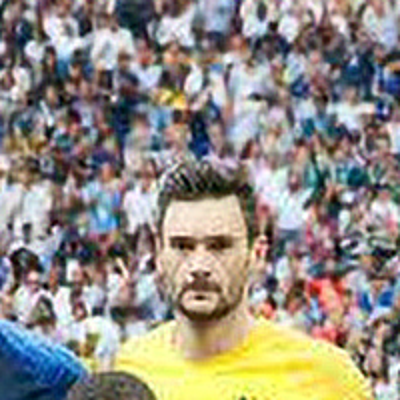

In [98]:
pred

The most efficient one seems to be the residual dense network with noise canceling weights (https://arxiv.org/abs/1802.08797). <br>
To improve the model, we could use a dataset of soccer teams pictures and their compressed version to fine tune the neural network.